In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import plotly.express as px
from warnings import filterwarnings
filterwarnings('ignore')

In [2]:
path=r'C:\Users\sandy4232\Desktop\Data analyst projects\time series project\individual_stocks_5yr'
company_list = os.listdir(path)
all_data=pd.DataFrame() #blank dataframe
for file in company_list:
    current_df=pd.read_csv(path+'/'+file)
    all_data=pd.concat([all_data,current_df])
all_data.shape

(624076, 7)

In [3]:
all_data

,date,open,high,low,close,volume,Name
0,2013-02-08,15.07,15.12,14.63,14.75,8407500,AAL
1,2013-02-11,14.89,15.01,14.26,14.46,8882000,AAL
2,2013-02-12,14.45,14.51,14.10,14.27,8126000,AAL
3,2013-02-13,14.30,14.94,14.25,14.66,10259500,AAL
4,2013-02-14,14.94,14.96,13.16,13.99,31879900,AAL
...,...,...,...,...,...,...,...
1254,2018-02-01,76.84,78.27,76.69,77.82,2982259,ZTS
1255,2018-02-02,77.53,78.12,76.73,76.78,2595187,ZTS
1256,2018-02-05,76.64,76.92,73.18,73.83,2962031,ZTS
1257,2018-02-06,72.74,74.56,72.13,73.27,4924323,ZTS


# Analyis Closing Price of All The Stocks

In [4]:
all_data.corr()['close']

open      0.999872
high      0.999936
low       0.999939
close     1.000000
volume   -0.143813
Name: close, dtype: float64

In [5]:
all_st_name=all_data['Name'].unique()
all_data['Name'].nunique()

505

In [6]:
all_data['date']=pd.to_datetime(all_data['date'])

In [7]:
all_data.dtypes

date      datetime64[ns]
open             float64
high             float64
low              float64
close            float64
volume             int64
Name              object
dtype: object

##### let's analyse the total volume of stock being traded each day

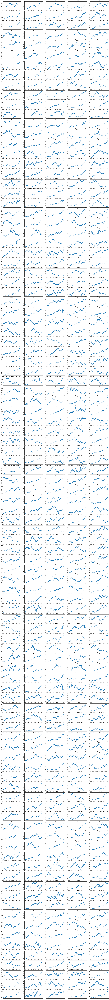

In [8]:
plt.figure(figsize=(30,300))
for i, company in enumerate(all_st_name,1):
    plt.subplot(105, 5, i)
    df=all_data[all_data['Name']==company]
    plt.plot(df['date'],df['close'])
    plt.title(company)

# Analyse The Total volume of stock being traded each day

##### using plotly

In [9]:
all_data

,date,open,high,low,close,volume,Name
0,2013-02-08,15.07,15.12,14.63,14.75,8407500,AAL
1,2013-02-11,14.89,15.01,14.26,14.46,8882000,AAL
2,2013-02-12,14.45,14.51,14.10,14.27,8126000,AAL
3,2013-02-13,14.30,14.94,14.25,14.66,10259500,AAL
4,2013-02-14,14.94,14.96,13.16,13.99,31879900,AAL
...,...,...,...,...,...,...,...
1254,2018-02-01,76.84,78.27,76.69,77.82,2982259,ZTS
1255,2018-02-02,77.53,78.12,76.73,76.78,2595187,ZTS
1256,2018-02-05,76.64,76.92,73.18,73.83,2962031,ZTS
1257,2018-02-06,72.74,74.56,72.13,73.27,4924323,ZTS


In [ ]:
for company in all_st_name:
    df=all_data[all_data['Name']==company]
    fig=px.line(df,x='date',y='volume',title=company)
    fig.show()

# Analyse Daily Price Change in Stock

In [11]:
df=pd.read_csv(r"C:\Users\sandy4232\Desktop\Data analyst projects\time series project\individual_stocks_5yr\AAPL_data.csv")

In [12]:
df.head()

,date,open,high,low,close,volume,Name
0,2013-02-08,67.7142,68.4014,66.8928,67.8542,158168416,AAPL
1,2013-02-11,68.0714,69.2771,67.6071,68.5614,129029425,AAPL
2,2013-02-12,68.5014,68.9114,66.8205,66.8428,151829363,AAPL
3,2013-02-13,66.7442,67.6628,66.1742,66.7156,118721995,AAPL
4,2013-02-14,66.3599,67.3771,66.2885,66.6556,88809154,AAPL


In [13]:
df['Daily_price_Change']=df['close']-df['open']

In [14]:
df.head()

,date,open,high,low,close,volume,Name,Daily_price_Change
0,2013-02-08,67.7142,68.4014,66.8928,67.8542,158168416,AAPL,0.1400
1,2013-02-11,68.0714,69.2771,67.6071,68.5614,129029425,AAPL,0.4900
2,2013-02-12,68.5014,68.9114,66.8205,66.8428,151829363,AAPL,-1.6586
3,2013-02-13,66.7442,67.6628,66.1742,66.7156,118721995,AAPL,-0.0286
4,2013-02-14,66.3599,67.3771,66.2885,66.6556,88809154,AAPL,0.2957


In [15]:
df['1day % Return']=df['Daily_price_Change']/df['close']*100

In [16]:
df.head()

,date,open,high,low,close,volume,Name,Daily_price_Change,1day % Return
0,2013-02-08,67.7142,68.4014,66.8928,67.8542,158168416,AAPL,0.1400,0.206325
1,2013-02-11,68.0714,69.2771,67.6071,68.5614,129029425,AAPL,0.4900,0.714688
2,2013-02-12,68.5014,68.9114,66.8205,66.8428,151829363,AAPL,-1.6586,-2.481344
3,2013-02-13,66.7442,67.6628,66.1742,66.7156,118721995,AAPL,-0.0286,-0.042869
4,2013-02-14,66.3599,67.3771,66.2885,66.6556,88809154,AAPL,0.2957,0.443624


In [17]:
fig=px.line(df,x='date',y='1day % Return',title='Apple')
fig.show()

# Analyse Monthly Mean Of Close Feature

In [18]:
df2=df.copy()

In [19]:
df2.dtypes

date                   object
open                  float64
high                  float64
low                   float64
close                 float64
volume                  int64
Name                   object
Daily_price_Change    float64
1day % Return         float64
dtype: object

In [20]:
df2['date']=pd.to_datetime(df2['date'])

In [21]:
df2.dtypes

date                  datetime64[ns]
open                         float64
high                         float64
low                          float64
close                        float64
volume                         int64
Name                          object
Daily_price_Change           float64
1day % Return                float64
dtype: object

In [22]:
df2.set_index('date',inplace=True)

In [23]:
df2

,open,high,low,close,volume,Name,Daily_price_Change,1day % Return
date,,,,,,,,
2013-02-08,67.7142,68.4014,66.8928,67.8542,158168416,AAPL,0.1400,0.206325
2013-02-11,68.0714,69.2771,67.6071,68.5614,129029425,AAPL,0.4900,0.714688
2013-02-12,68.5014,68.9114,66.8205,66.8428,151829363,AAPL,-1.6586,-2.481344
2013-02-13,66.7442,67.6628,66.1742,66.7156,118721995,AAPL,-0.0286,-0.042869
2013-02-14,66.3599,67.3771,66.2885,66.6556,88809154,AAPL,0.2957,0.443624
...,...,...,...,...,...,...,...,...
2018-02-01,167.1650,168.6200,166.7600,167.7800,47230787,AAPL,0.6150,0.366551
2018-02-02,166.0000,166.8000,160.1000,160.5000,86593825,AAPL,-5.5000,-3.426791
2018-02-05,159.1000,163.8800,156.0000,156.4900,72738522,AAPL,-2.6100,-1.667838


In [24]:
df2['2013-02-08':'2013-03-08']

,open,high,low,close,volume,Name,Daily_price_Change,1day % Return
date,,,,,,,,
2013-02-08,67.7142,68.4014,66.8928,67.8542,158168416,AAPL,0.1400,0.206325
2013-02-11,68.0714,69.2771,67.6071,68.5614,129029425,AAPL,0.4900,0.714688
2013-02-12,68.5014,68.9114,66.8205,66.8428,151829363,AAPL,-1.6586,-2.481344
2013-02-13,66.7442,67.6628,66.1742,66.7156,118721995,AAPL,-0.0286,-0.042869
2013-02-14,66.3599,67.3771,66.2885,66.6556,88809154,AAPL,0.2957,0.443624
2013-02-15,66.9785,67.1656,65.7028,65.7371,97924631,AAPL,-1.2414,-1.888431
2013-02-19,65.8714,66.1042,64.8356,65.7128,108854046,AAPL,-0.1586,-0.241353
2013-02-20,65.3842,65.3842,64.1142,64.1214,118891367,AAPL,-1.2628,-1.969389
2013-02-21,63.7142,64.1671,63.2599,63.7228,111596821,AAPL,0.0086,0.013496


In [25]:
pd.DataFrame(df2['close'].resample('M').mean())

,close
date,
2013-02-28,65.306264
2013-03-31,63.120110
2013-04-30,59.966432
2013-05-31,63.778927
2013-06-30,60.791120
...,...
2017-10-31,157.817273
2017-11-30,172.406190
2017-12-31,171.891500


<AxesSubplot:xlabel='date'>

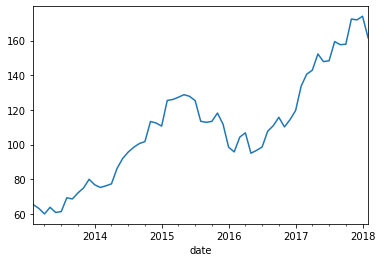

In [26]:
df2['close'].resample('M').mean().plot()

<AxesSubplot:xlabel='date'>

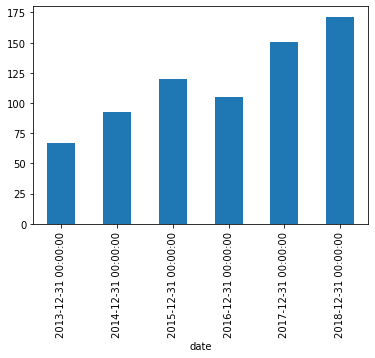

In [27]:
df2['close'].resample('Y').mean().plot(kind='bar')

# Analyis Whether Stock prices of These Tech Companies are corelated or not [AMAZON,APPLE,GOOGLE,MICROSOFT)

In [28]:
all_data.columns

Index(['date', 'open', 'high', 'low', 'close', 'volume', 'Name'], dtype='object')

In [29]:
all_data['Name'].unique()

array(['AAL', 'AAPL', 'AAP', 'ABBV', 'ABC', 'ABT', 'ACN', 'ADBE', 'ADI',
       'ADM', 'ADP', 'ADSK', 'ADS', 'AEE', 'AEP', 'AES', 'AET', 'AFL',
       'AGN', 'AIG', 'AIV', 'AIZ', 'AJG', 'AKAM', 'ALB', 'ALGN', 'ALK',
       'ALLE', 'ALL', 'ALXN', 'AMAT', 'AMD', 'AME', 'AMGN', 'AMG', 'AMP',
       'AMT', 'AMZN', 'ANDV', 'ANSS', 'ANTM', 'AON', 'AOS', 'APA', 'APC',
       'APD', 'APH', 'APTV', 'ARE', 'ARNC', 'ATVI', 'AVB', 'AVGO', 'AVY',
       'AWK', 'AXP', 'AYI', 'AZO', 'A', 'BAC', 'BAX', 'BA', 'BBT', 'BBY',
       'BDX', 'BEN', 'BF.B', 'BHF', 'BHGE', 'BIIB', 'BK', 'BLK', 'BLL',
       'BMY', 'BRK.B', 'BSX', 'BWA', 'BXP', 'CAG', 'CAH', 'CAT', 'CA',
       'CBG', 'CBOE', 'CBS', 'CB', 'CCI', 'CCL', 'CDNS', 'CELG', 'CERN',
       'CFG', 'CF', 'CHD', 'CHK', 'CHRW', 'CHTR', 'CINF', 'CI', 'CLX',
       'CL', 'CMA', 'CMCSA', 'CME', 'CMG', 'CMI', 'CMS', 'CNC', 'CNP',
       'COF', 'COG', 'COL', 'COO', 'COP', 'COST', 'COTY', 'CPB', 'CRM',
       'CSCO', 'CSRA', 'CSX', 'CTAS', 'CTL', 'CTSH', 'CTXS

In [30]:
apple=all_data[all_data['Name']=='AAPL']
apple

,date,open,high,low,close,volume,Name
0,2013-02-08,67.7142,68.4014,66.8928,67.8542,158168416,AAPL
1,2013-02-11,68.0714,69.2771,67.6071,68.5614,129029425,AAPL
2,2013-02-12,68.5014,68.9114,66.8205,66.8428,151829363,AAPL
3,2013-02-13,66.7442,67.6628,66.1742,66.7156,118721995,AAPL
4,2013-02-14,66.3599,67.3771,66.2885,66.6556,88809154,AAPL
...,...,...,...,...,...,...,...
1254,2018-02-01,167.1650,168.6200,166.7600,167.7800,47230787,AAPL
1255,2018-02-02,166.0000,166.8000,160.1000,160.5000,86593825,AAPL
1256,2018-02-05,159.1000,163.8800,156.0000,156.4900,72738522,AAPL
1257,2018-02-06,154.8300,163.7200,154.0000,163.0300,68243838,AAPL


In [31]:
amazon=all_data[all_data['Name']=='AMZN']
amazon

,date,open,high,low,close,volume,Name
0,2013-02-08,261.40,265.25,260.555,261.95,3879078,AMZN
1,2013-02-11,263.20,263.25,256.600,257.21,3403403,AMZN
2,2013-02-12,259.19,260.16,257.000,258.70,2938660,AMZN
3,2013-02-13,261.53,269.96,260.300,269.47,5292996,AMZN
4,2013-02-14,267.37,270.65,265.400,269.24,3462780,AMZN
...,...,...,...,...,...,...,...
1254,2018-02-01,1445.00,1459.88,1385.140,1390.00,9113808,AMZN
1255,2018-02-02,1477.39,1498.00,1414.000,1429.95,11125722,AMZN
1256,2018-02-05,1402.62,1458.98,1320.720,1390.00,11494985,AMZN
1257,2018-02-06,1361.46,1443.99,1351.790,1442.84,11066819,AMZN


In [32]:
google=all_data[all_data['Name']=='GOOG']
google

,date,open,high,low,close,volume,Name
0,2014-03-27,568.000,568.00,552.92,558.46,13052,GOOG
1,2014-03-28,561.200,566.43,558.67,559.99,41003,GOOG
2,2014-03-31,566.890,567.00,556.93,556.97,10772,GOOG
3,2014-04-01,558.710,568.45,558.71,567.16,7932,GOOG
4,2014-04-02,565.106,604.83,562.19,567.00,146697,GOOG
...,...,...,...,...,...,...,...
970,2018-02-01,1162.610,1174.00,1157.52,1167.70,2412114,GOOG
971,2018-02-02,1122.000,1123.07,1107.28,1111.90,4857943,GOOG
972,2018-02-05,1090.600,1110.00,1052.03,1055.80,3798301,GOOG
973,2018-02-06,1027.180,1081.71,1023.14,1080.60,3447956,GOOG


In [33]:
microsoft=all_data[all_data['Name']=='MSFT']
microsoft

,date,open,high,low,close,volume,Name
0,2013-02-08,27.35,27.710,27.3100,27.55,33318306,MSFT
1,2013-02-11,27.65,27.920,27.5000,27.86,32247549,MSFT
2,2013-02-12,27.88,28.000,27.7500,27.88,35990829,MSFT
3,2013-02-13,27.93,28.110,27.8800,28.03,41715530,MSFT
4,2013-02-14,27.92,28.060,27.8700,28.04,32663174,MSFT
...,...,...,...,...,...,...,...
1254,2018-02-01,94.79,96.070,93.5813,94.26,47227882,MSFT
1255,2018-02-02,93.64,93.970,91.5000,91.78,47867753,MSFT
1256,2018-02-05,90.56,93.240,88.0000,88.00,51031465,MSFT
1257,2018-02-06,86.89,91.475,85.2500,91.33,67998564,MSFT


In [34]:
close=pd.DataFrame()

In [35]:
close['apple']=apple['close']
close['amazon']=amazon['close']
close['microsoft']=microsoft['close']
close['google']=google['close']

In [36]:
close

,apple,amazon,microsoft,google
0,67.8542,261.95,27.55,558.46
1,68.5614,257.21,27.86,559.99
2,66.8428,258.70,27.88,556.97
3,66.7156,269.47,28.03,567.16
4,66.6556,269.24,28.04,567.00
...,...,...,...,...
1254,167.7800,1390.00,94.26,NaN
1255,160.5000,1429.95,91.78,NaN
1256,156.4900,1390.00,88.00,NaN
1257,163.0300,1442.84,91.33,NaN


##### Multi-variate Analysis

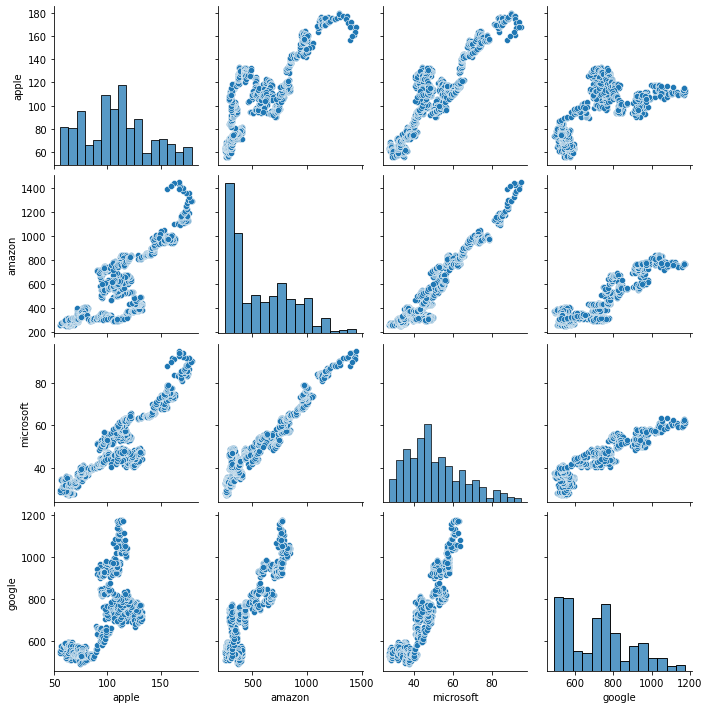

In [37]:
sns.pairplot(data=close)

##### co-relation plot for stock prices 

<AxesSubplot:>

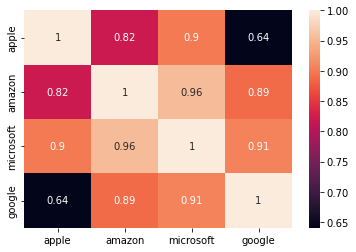

In [38]:
sns.heatmap(close.corr(),annot=True)

###### Closing price of Google and Microsoft are well correlated
       and Closing price of Amazon and Microsoft have a co-relation of 0.96

# Analyse Daily Return Of Each Stock And How They Are Co-Related

In [39]:
data=pd.DataFrame()

In [40]:
data['apple_change']=((apple['close']-apple['open'])/apple['close'])*100
data['Google_change']=((google['close']-google['open'])/google['close'])*100
data['Microsoft_change']=((microsoft['close']-microsoft['open'])/microsoft['close'])*100
data['Amazon_change']=((amazon['close']-amazon['open'])/amazon['close'])*100

In [41]:
data

,apple_change,Google_change,Microsoft_change,Amazon_change
0,0.206325,-1.708269,0.725953,0.209964
1,0.714688,-0.216075,0.753769,-2.328836
2,-2.481344,-1.781065,0.000000,-0.189409
3,-0.042869,1.489879,0.356761,2.946525
4,0.443624,0.334039,0.427960,0.694548
...,...,...,...,...
1254,0.366551,NaN,-0.562275,-3.956835
1255,-3.426791,NaN,-2.026585,-3.317599
1256,-1.667838,NaN,-2.909091,-0.907914
1257,5.029749,NaN,4.861491,5.640265


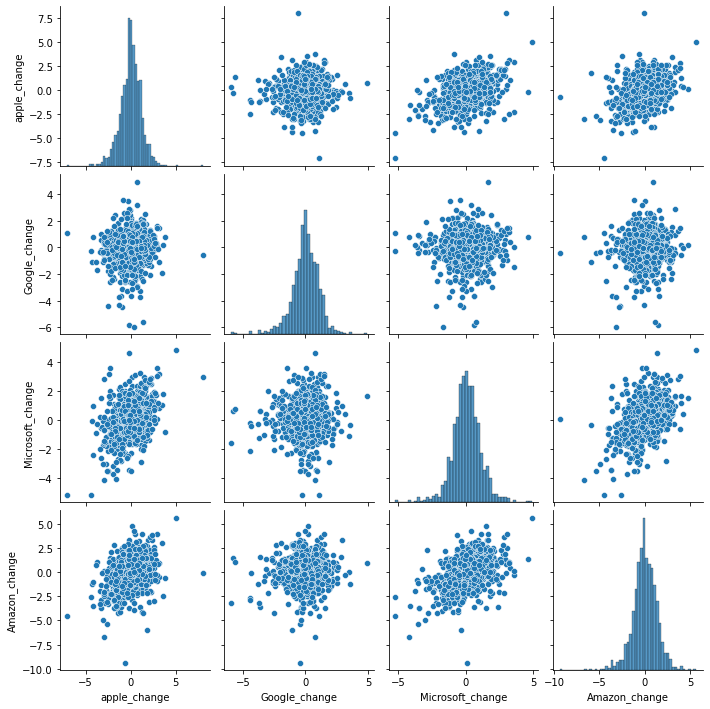

In [42]:
sns.pairplot(data=data)

##### Correlation plot for daily returns

<AxesSubplot:>

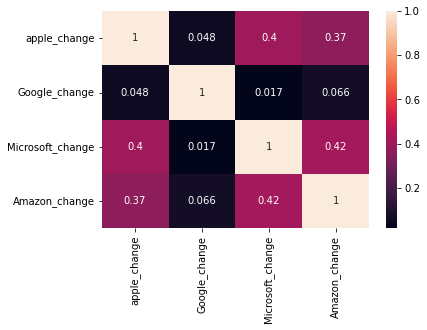

In [43]:
sns.heatmap(data.corr(),annot=True)

##### We can see that Amazon and microsoft have good correlation on daily returns

# Value Risk Analysis For Tech Companies

##### APPLE

<AxesSubplot:xlabel='apple_change', ylabel='Density'>

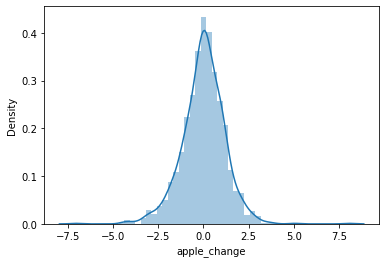

In [44]:
sns.distplot(data['apple_change'])

##### it somehow follows a normal distribution

In [45]:
data['apple_change'].std()

1.1871377131421237

In [46]:
data['apple_change'].std()*2

2.3742754262842474

In [47]:
data['apple_change'].std()*3

3.561413139426371

In [48]:
data['apple_change'].quantile(0.1)

-1.4246644227944307

##### 1.4246644227944307 means that 90% of the times the worst daily Loss will not exceed 1.42

In [49]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
apple_change,1259.0,-0.000215,1.187138,-7.104299,-0.658021,0.042230,0.715427,8.000388
Google_change,975.0,-0.012495,1.092560,-5.952266,-0.551963,0.024951,0.672649,4.943550
Microsoft_change,1259.0,0.076404,1.059260,-5.177618,-0.509241,0.061069,0.703264,4.861491
Amazon_change,1259.0,-0.000398,1.358679,-9.363077,-0.738341,-0.002623,0.852568,5.640265


#### AMAZON

<AxesSubplot:xlabel='Amazon_change', ylabel='Density'>

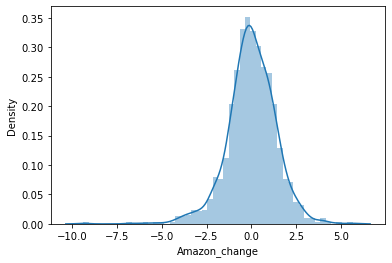

In [50]:
sns.distplot(data['Amazon_change'])

In [53]:
data['Amazon_change'].std()

1.35867860994955

In [52]:
data['Amazon_change'].quantile(0.1)

-1.5247436499501366

##### -1.5247436499501366 means that 90% of the times the worst daily Loss will not exceed 1.52

#### microsoft

<AxesSubplot:xlabel='Microsoft_change', ylabel='Density'>

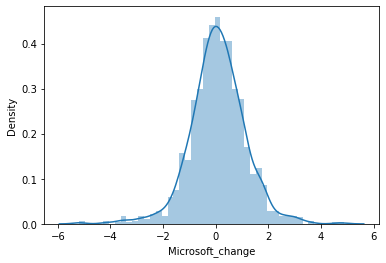

In [55]:
sns.distplot(data['Microsoft_change'])

In [56]:
data['Microsoft_change'].std()

1.059259601884536

In [57]:
data['Microsoft_change'].quantile(0.1)

-1.1385681979964504